In [1]:
import os
import numpy as np
import mne
import imageio
import h5py
#import scipy.fftpack
import matplotlib
%matplotlib inline
import pywt
from matplotlib.ticker import ScalarFormatter
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
#from scipy import signal
from matplotlib.colors import ListedColormap
import time
import seaborn as sns
#import scipy.io as sio
#from scipy.integrate import simps
import pandas as pd
#from scipy import fft
import matplotlib.mlab as mlab
import sys
sys.path.append(r'C:\Users\rburman.MSDITUN-TMV0GCR\Dropbox\Postdoc\projects\code\CCEP_human\Python_Analysis\py_functions')
import analys_func
from scipy.stats import norm
import LL_funcs
from scipy.stats import norm
from tkinter import filedialog
from tkinter import *
import ntpath
root = Tk()
root.withdraw()
import math
import scipy
from scipy import signal
import pylab
import scipy.cluster.hierarchy as sch
from scipy.spatial.distance import squareform
import platform
from glob import glob
from scipy.io import savemat

import basic_func as bf
from scipy.integrate import simps
from numpy import trapz

import tqdm
from matplotlib.patches import Rectangle

import ptitprince as pt


import freq_funcs as ff
subj            = "EL018"
cwd             = os.getcwd()

import IO_func as IOf
import basic_func as bf
import LL_funcs as LLf

# Setting paths and parameters

In [2]:
#setting paths

path_patient = r'C:\Users\rburman.MSDITUN-TMV0GCR\Dropbox\Postdoc\projects\coeus\data\seeg\data\\'+subj

path_analysis = r'C:\Users\rburman.MSDITUN-TMV0GCR\Dropbox\Postdoc\projects\coeus\data\seeg\analysis\\'+subj


#setting parameters

sep =';'    

color_elab      = ['#a5c6e2', "#397bb3","#1b3b56"]
lbls            = pd.read_excel(path_patient + "/infos/" + subj + "_labels.xlsx", header=0, sheet_name='BP')
labels_all      = lbls.label.values
labels_clinic   = lbls.Clinic.values
labels_region   = lbls.Region.values
labels_L        = lbls.Hemisphere.values
nodes           = pd.DataFrame({'ID': labels_all, 'Region': labels_region, 'H': labels_L})
coord_all       = np.array([lbls.x.values,lbls.y.values, lbls.z.values ]).T
#if subj == 'EL006':
 #     labels_all      = lbls.Clinic.values

bad_stims = np.where(labels_region=='OUT')[0]

Fs             = 500
dur            = np.zeros((1,2), dtype=np.int32)
t0 = 1
dur[0,0] =  -t0
dur[0,1] =  3

#dur[0,:]       = np.int32(np.sum(abs(dur)))
x_ax           = np.arange(dur[0,0],dur[0,1],(1/Fs))
color_elab      = np.zeros((4,3))
color_elab[0,:] = np.array([165, 198, 226])/255
color_elab[1,:] = np.array([57, 123, 179])/255
color_elab[2,:] = np.array([27, 59, 86])/255
cond_label = ['Pre', 'Post early', 'Post late', 'New']

## Read Data

In [3]:
prot = 'LTD1'

#still to do: select bad channels in epitome
bad_chans  = pd.read_csv(path_patient + '\\LongTermInduction\\data\\badchan.csv')
bad_chans = np.unique(np.array(np.where(bad_chans.values[:,1:]==1))[0,:])

# load data
files = glob(path_patient + '\\LongTermInduction\\data\\Stim_list_*')
file = files[0] # first file
EEG_resp = np.load(path_patient + '\\LongTermInduction\\data\\All_resps_'+ntpath.basename(file)[10:-4]+'.npy')
stimlist = pd.read_csv(file)


##labels etc.
lbls = pd.read_excel(path_patient + "/infos/" + subj + "_labels.xlsx", header=0, sheet_name='BP')
labels_all, labels_region, labels_clinic, coord_all, StimChans, StimChanSM, StimChansC, StimChanIx, stimlist = bf.get_Stim_chans(
    stimlist,
    lbls)

# clean stimlist, dlete columns you dont need
for col in ['Condition','currentflow', 'TTL', 'TTL_PP', 'TTL_DS', 'TTL_PP_DS', 'sleep', 'sz', 'condition', 'Int_cond','ISI_s']:
    if col in stimlist: stimlist = stimlist.drop(columns=col)
        
stimlist.insert(6, 'Condition', 'Pre')
stimlist.loc[(stimlist.type=='LTD1_IO')&(stimlist.stim_block>4),'Condition'] ='Post_early'
stimlist.loc[(stimlist.type=='LTD1_IO')&(stimlist.stim_block>8),'Condition'] ='Post_late'

stimlist.loc[(stimlist.type=='LTD1_SP')&(stimlist.stim_block>1),'Condition'] ='Post_early'
stimlist.loc[(stimlist.type=='LTD1_SP')&(stimlist.stim_block>2),'Condition'] ='Post_late'

## Get LL of each stimulation trial and each channel

In [4]:
def SM2IX(SM, StimChanNums, StimChanIx):
    # SM: stim channel in SM number
    # StimChanNums: all number of stim channels in SM
    # StimChanIx: all stim channels in all channels environment
    ChanIx = np.zeros_like(SM)
    for i in range(len(SM)):
        ChanIx[i] = StimChanIx[np.where(StimChanNums == SM[i])]
    return ChanIx

In [5]:
def get_LL_all_LTI(EEG_resp, stimlist, lbls, bad_chans, Fs=500,t_0=1,w_LL=0.25):
    labels_all, labels_region, labels_clinic, coord_all, StimChans, StimChanSM,StimChansC, StimChanIx, stimlist = bf.get_Stim_chans(stimlist,
                                                                                                          lbls)
    data_LL = np.zeros((1, 12))  # RespChan, Int, LL, LLnorm, State
    stim_spec = stimlist[(stimlist.IPI_ms == 0) ]  # &(stimlist.noise ==0)
    stimNum = stim_spec.Num.values  # [:,0]
    noise_val = stim_spec.noise.values  # [:,0]
    if len(stimNum)>0:
        #resps = EEG_resp[:, stimNum, :]
        resps = EEG_resp[:, stimNum, :]
        ChanP1 = bf.SM2IX(stim_spec.ChanP.values, StimChanSM, np.array(StimChanIx))
        IPIs = np.expand_dims(np.array(stim_spec.IPI_ms.values), 1)
        #LL = LLf.get_LL_both(data=resps, Fs=Fs, IPI=IPIs, t_0=1, win=w)
        LL_trial = LLf.get_LL_all(resps[:, :, int(t_0 * Fs):int((t_0+0.5) * Fs)], Fs, w_LL)
        LL_peak = np.max(LL_trial, 2)
        t_peak = np.argmax(LL_trial, 2) + int((t_0 - w_LL / 2) * Fs)
        t_peak[t_peak < (t_0 * Fs)] = t_0 * Fs
        inds = np.repeat(np.expand_dims(t_peak, 2), int(w_LL * Fs), 2)
        inds = inds + np.arange(int(w_LL * Fs))
        pN = np.min(np.take_along_axis(resps, inds, axis=2), 2)
        pP = np.max(np.take_along_axis(resps, inds, axis=2), 2)
        p2p = abs(pP - pN)
        for c in range(len(LL_peak)):
            val = np.zeros((LL_peak.shape[1], 12))
            val[:, 0] = c  # response channel
            val[:, 1] = ChanP1
            val[:, 4] = stim_spec.Int_prob.values  # Intensity
            val[:, 3] = noise_val
            val[:, 2] = LL_peak[c, :]  # PP
            val[:, 7] = stimNum
            val[:, 10] = stim_spec.stim_block.values
            val[:, 11] =  p2p[c, :]  # LL_peak_ratio[c, :]  # ratio
            # set stimulation channels to nan
            val[np.where(bf.check_inStimChan(c, ChanP1, labels_clinic) == 1), 3] = 1
            val[np.where(bf.check_inStimChan(c, ChanP1, labels_clinic) == 1), 2] = np.nan
            # if its the recovery channel, check if strange peak is appearing
            pks = np.max(abs(resps[c, :, np.int64((t_0 - 0.05) * Fs):np.int64((t_0 + 0.5) * Fs)]), 1)
            pks_loc = np.argmax(abs(resps[c, :, np.int64((t_0 - 0.05) * Fs):np.int64((t_0 + 0.5) * Fs)]), 1) + np.int64(
                (t_0 - 0.05) * Fs)
            ix = np.where(
                (pks > 500) & (pks_loc > np.int64((t_0 - 0.005) * Fs)) & (pks_loc < np.int64((t_0 + 0.008) * Fs)))
            # original stim number:
            sn = stim_spec.StimNum.values[ix]
            rec_chan = stimlist.loc[np.isin(stimlist.StimNum, sn - 1), 'ChanP'].values
            rec_chan = SM2IX(rec_chan, StimChanSM, np.array(StimChanIx))
            if np.isin(c, rec_chan):
                val[ix, 3] = 1

            data_LL = np.concatenate((data_LL, val), axis=0)

        data_LL = data_LL[1:-1, :]  # remove first row (dummy row)
        LL_all = pd.DataFrame(
            {"Chan": data_LL[:, 0], "Stim": data_LL[:, 1], "LL": data_LL[:, 2], "P2P": data_LL[:, 11], "Artefact": data_LL[:, 3],
             "Int": data_LL[:, 4], "Block": data_LL[:, 10],
             "Num": data_LL[:, 7],"Num_block": data_LL[:, 7]})

        # distance
        for s in np.unique(LL_all.Stim):
            s = np.int64(s)
            for c in np.unique(LL_all.Chan):
                c = np.int64(c)
                LL_all.loc[(LL_all.Stim == s) & (LL_all.Chan == c), 'd'] = np.round(
                    scipy.spatial.distance.euclidean(coord_all[s], coord_all[c]), 2)
    return LL_all


In [6]:
LL_all  = get_LL_all_LTI(EEG_resp, stimlist, lbls, bad_chans, Fs=500,t_0=1,w_LL=0.25)

In [7]:
LL_all.insert(4,'Condition', 'Pre')
LL_all.insert(4,'type', 'IO')
for stim_num in np.unique(LL_all.Num):
    LL_all.loc[LL_all.Num==stim_num, 'Condition'] = stimlist.loc[stimlist.Num == stim_num,'Condition'].values[0]
    LL_all.loc[LL_all.Num==stim_num, 'type'] = stimlist.loc[stimlist.Num == stim_num,'type'].values[0]

## Preliminary Plots

In [8]:
cond_labels = ['Pre','Post_early', 'Post_late'] # cond_labels = np.unique(LL_all.Condition)
cond_vals = np.arange(len(cond_labels))

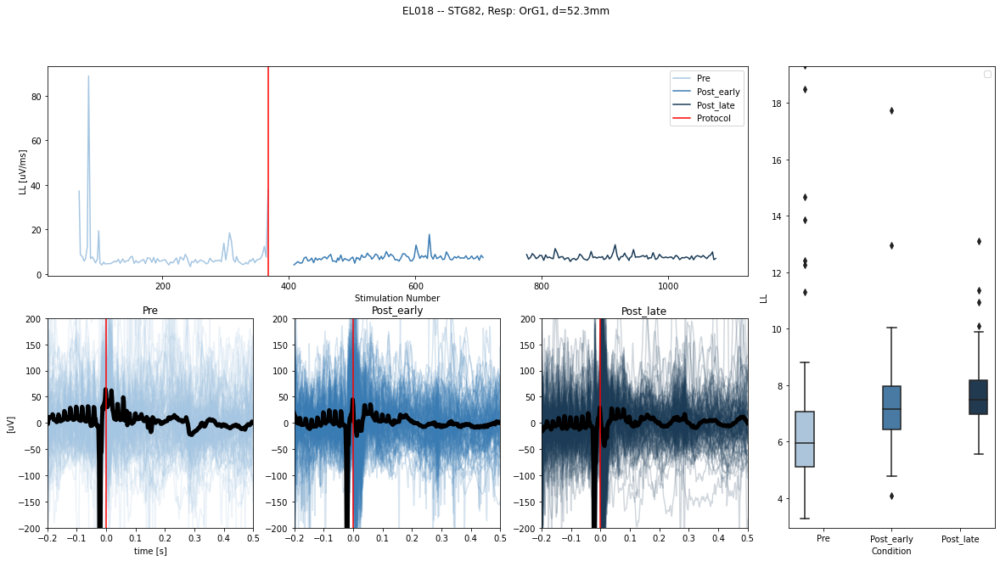

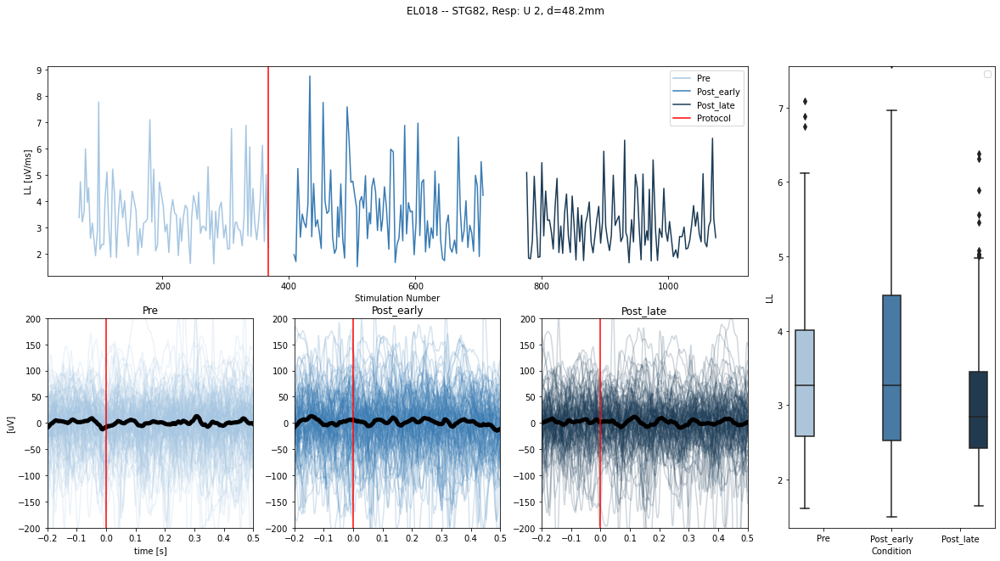

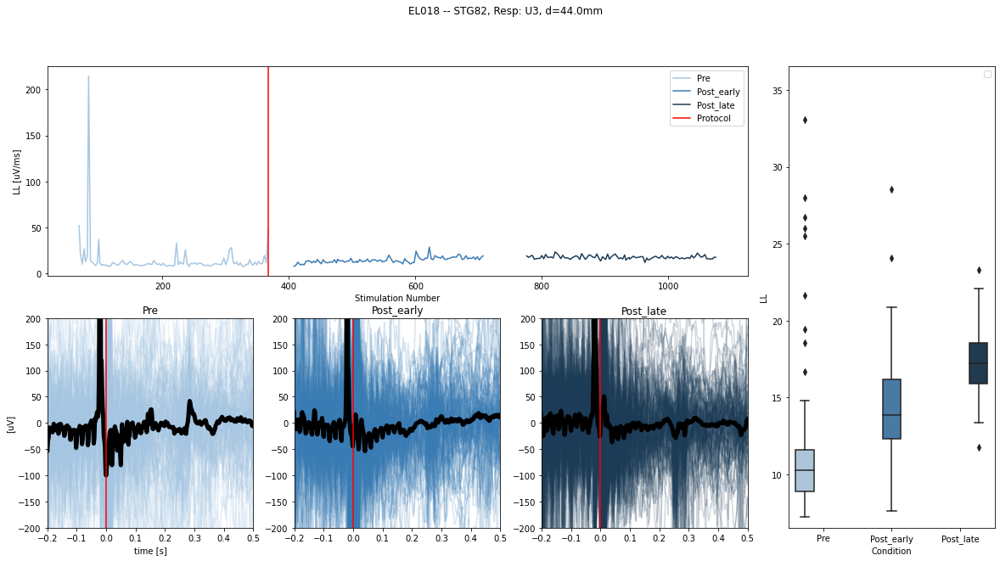

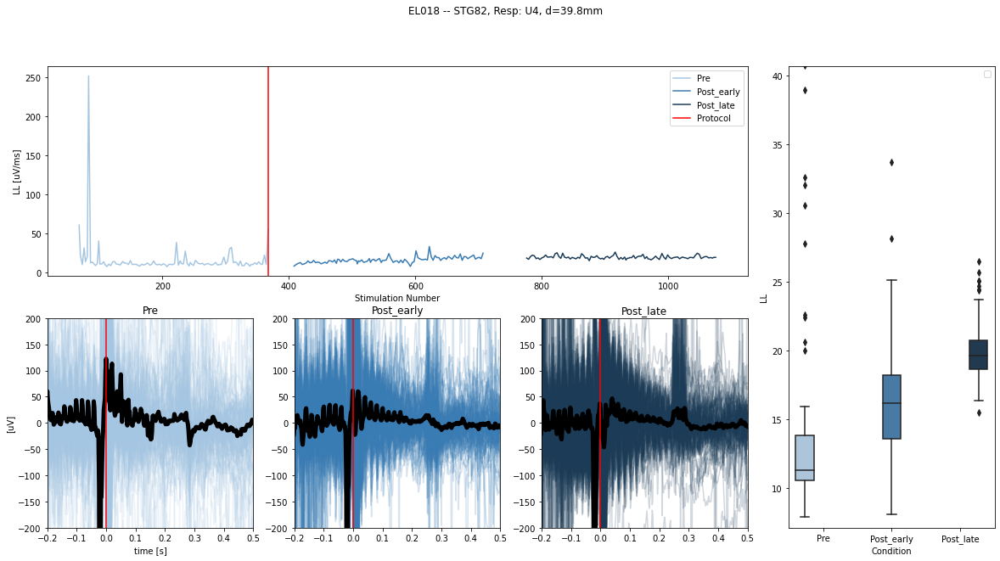

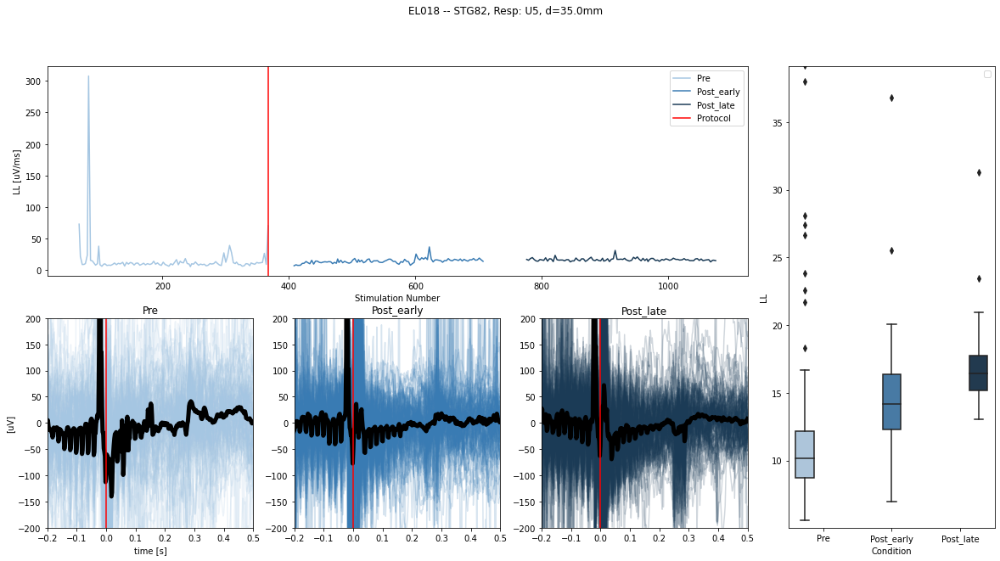

...

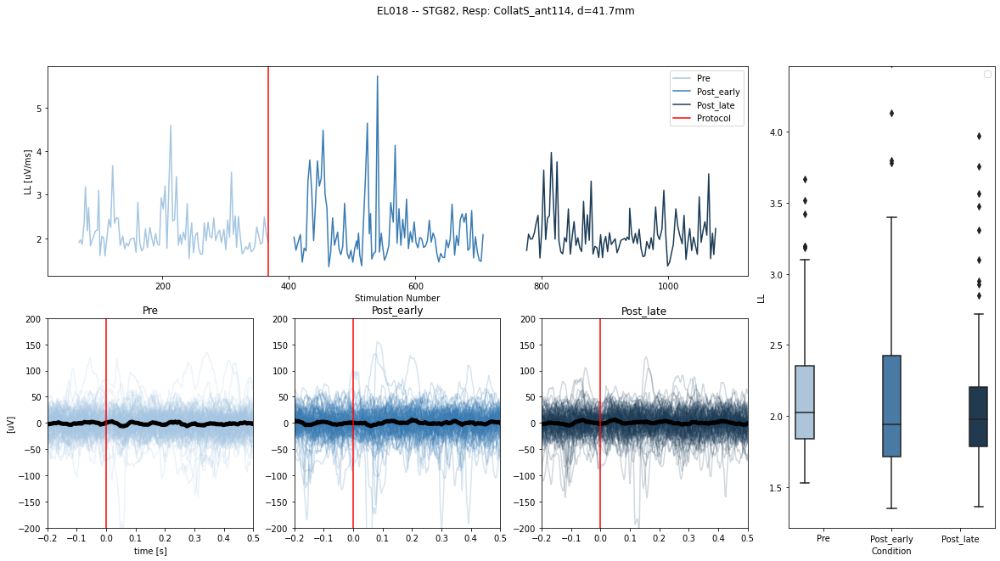

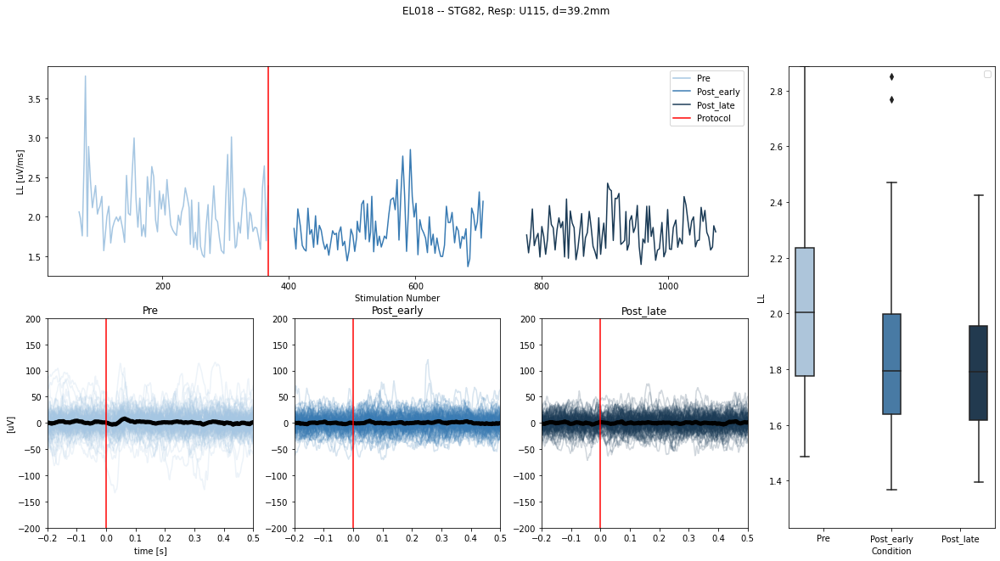

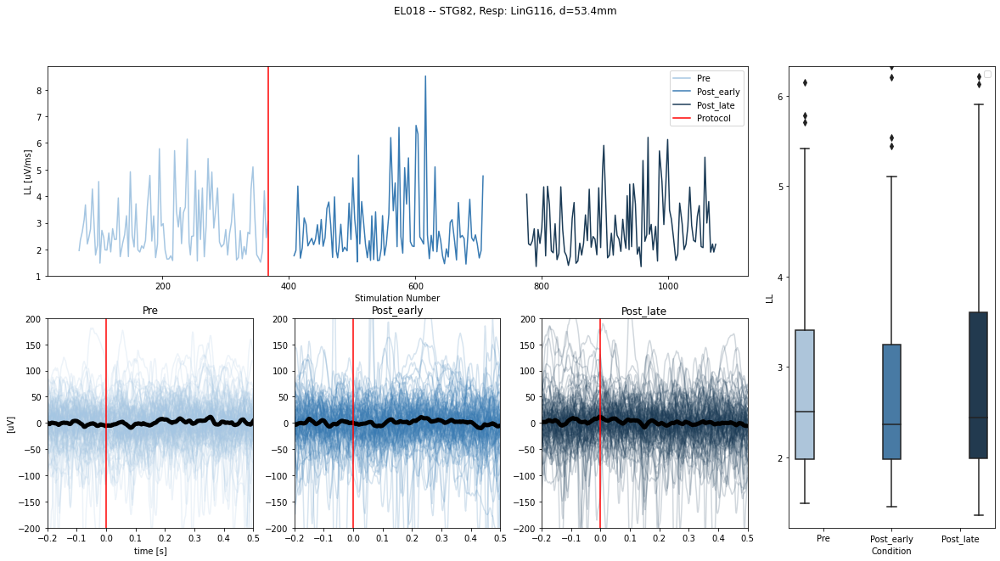

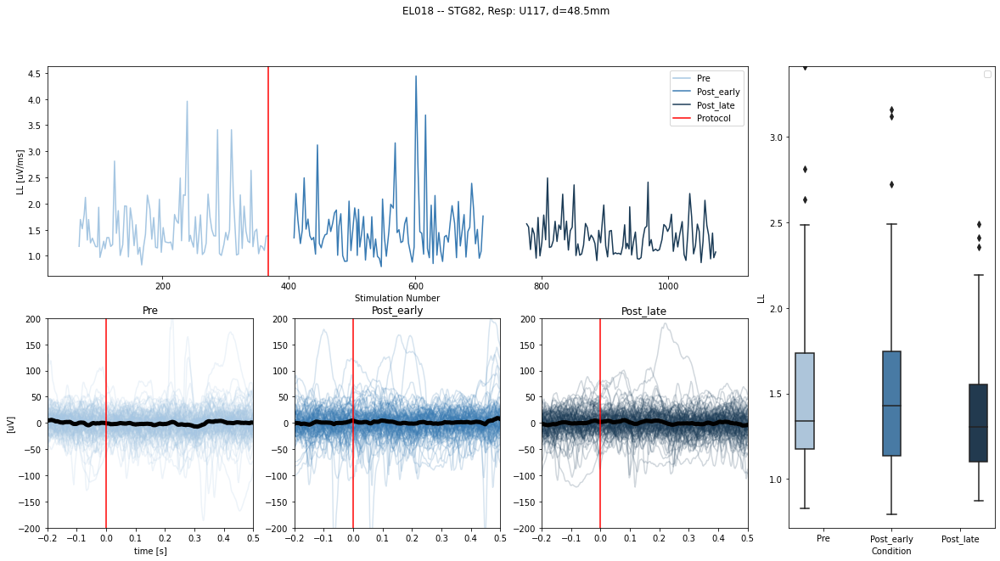

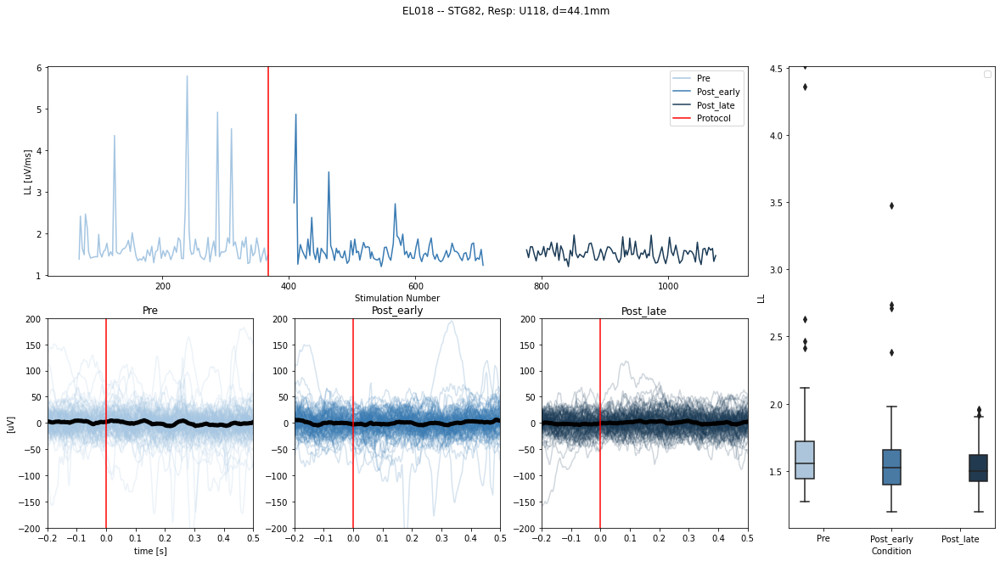

In [9]:
# select data for specific response channel (rc)
#rc = 24 # rc+1
for rc in np.unique(LL_all.loc[(LL_all.d>0)&(LL_all.d<60),'Chan']).astype('int'):
    dat      = LL_all[(LL_all['type']=='LTD1_SP')&(LL_all['Artefact']==0)&(LL_all['Chan']==rc)] #(LL_all['Stim']>32)& #&(LL_all['Sig_Con']>0)
    
    if len(dat) > 0:
        sc = int(dat.Stim.values[0])

        fig      = plt.figure(figsize=(20,10), facecolor='w', edgecolor='k')
        plt.suptitle(subj+' -- '+labels_all[np.int64(sc)]+', Resp: '+labels_all[np.int64(rc)]+', d='+str(np.round(np.mean(dat.d),1))+'mm')    #
        gs       = fig.add_gridspec(2,4)  # GridSpec(4,1, height_ratios=[1,2,1,2])
        fig.add_subplot(gs[0, 0:3])
        for c,i in zip(cond_labels, cond_vals):
            dat_plot = dat[(dat.Condition==c)]
            plt.plot(dat_plot.Num, dat_plot.LL, color=color_elab[i], label=c)
        plt.xlabel('Stimulation Number')
        plt.ylabel('LL [uV/ms]')
        plt.axvline(np.max(dat.loc[(dat.Block==1),'Num'])+0.5, color=[1,0,0], label='Protocol')
        plt.legend()  
        ylim_mn = -100
        ylim_mx = 100
        for c,i in zip(cond_labels, cond_vals):

            dat_plot = dat[(dat.Condition==c)]

            ax = fig.add_subplot(gs[1, i])
            for j in range(len(dat_plot.Num.values.astype('int'))):
                plt.plot(x_ax, EEG_resp[rc, dat_plot.Num.values.astype('int')[j],:],color=color_elab[i], alpha=0.2)
            plt.plot(x_ax, np.mean(EEG_resp[rc, dat_plot.Num.values.astype('int'),:],0),color=[0,0,0], linewidth=5)
            ylim_mx = np.max([ylim_mx, np.max(np.mean(EEG_resp[rc, dat_plot.Num.values.astype('int'),500:750],0))])
            ylim_mn = np.min([ylim_mn, np.min(np.mean(EEG_resp[rc, dat_plot.Num.values.astype('int'),500:750],0))])
            plt.xlim([-0.2, 0.5])
            plt.axvline(0, color=[1,0,0])
            plt.ylim([-200,200])
            if i==0:
                plt.xlabel('time [s]')
                plt.ylabel('[uV]')
            plt.title(c)
        #for i in range(len(cond_labels)):
        #    fig.add_subplot(gs[1, i])
        #    plt.ylim([1.3*ylim_mn, 1.5*ylim_mx])

        fig.add_subplot(gs[:, 3])
        sns.boxplot(x='Condition', y='LL', data = dat, hue = 'Condition', palette=color_elab)    
        plt.xticks(np.arange(np.max(cond_vals)+1),cond_labels)
        plt.ylim([0.9*np.min(dat.LL),np.percentile(dat.LL,99)])
        plt.legend([])
        plt.show()

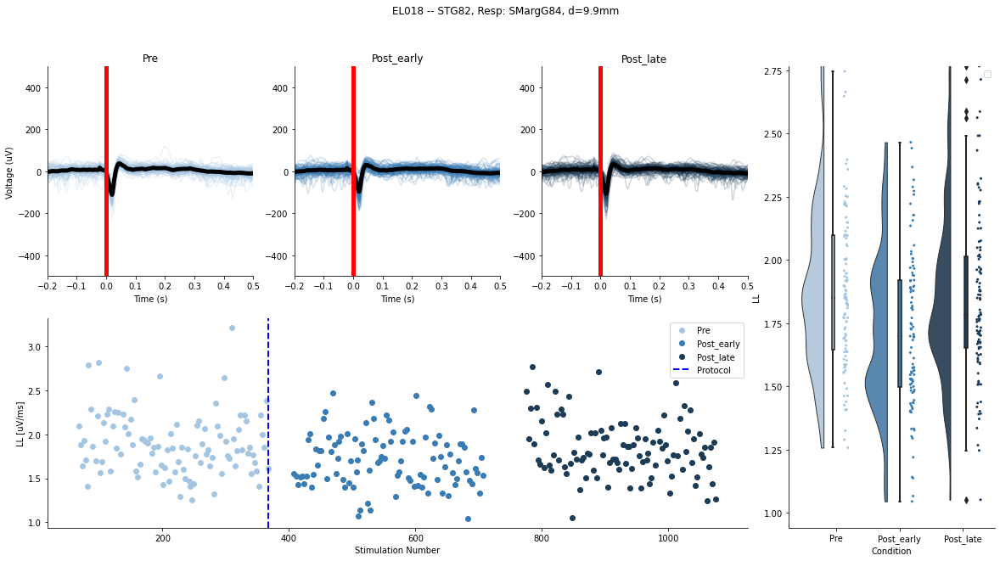

In [10]:
# select data for specific response channel (rc)
rc = 83
dat      = LL_all[(LL_all['type']=='LTD1_SP')&(LL_all['Artefact']==0)&(LL_all['Chan']==rc)] #(LL_all['Stim']>32)& #&(LL_all['Sig_Con']>0)

if len(dat) > 0:
    sc = int(dat.Stim.values[0])

    fig      = plt.figure(figsize=(20,10), facecolor='w', edgecolor='k')
    plt.suptitle(subj+' -- '+labels_all[np.int64(sc)]+', Resp: '+labels_all[np.int64(rc)]+', d='+str(np.round(np.mean(dat.d),1))+'mm')    #
    gs       = fig.add_gridspec(2,4)  # GridSpec(4,1, height_ratios=[1,2,1,2])
    fig.add_subplot(gs[1, 0:3])
    for c,i in zip(cond_labels, cond_vals):
        dat_plot = dat[(dat.Condition==c)]
        plt.scatter(dat_plot.Num, dat_plot.LL, color=color_elab[i], label=c)
    plt.xlabel('Stimulation Number')
    plt.ylabel('LL [uV/ms]')
    plt.axvline(np.max(dat.loc[(dat.Block==1),'Num'])+0.5, color='blue',label='Protocol',lw=2,linestyle='dashed')
    plt.legend()  
    ylim_mn = -100
    ylim_mx = 100
    for c,i in zip(cond_labels, cond_vals):

        dat_plot = dat[(dat.Condition==c)]

        ax = fig.add_subplot(gs[0, i])
        for j in range(len(dat_plot.Num.values.astype('int'))):
            plt.plot(x_ax, EEG_resp[rc, dat_plot.Num.values.astype('int')[j],:],color=color_elab[i], alpha=0.2)
        plt.plot(x_ax, np.mean(EEG_resp[rc, dat_plot.Num.values.astype('int'),:],0),color=[0,0,0], linewidth=5)
        ylim_mx = np.max([ylim_mx, np.max(np.mean(EEG_resp[rc, dat_plot.Num.values.astype('int'),500:750],0))])
        ylim_mn = np.min([ylim_mn, np.min(np.mean(EEG_resp[rc, dat_plot.Num.values.astype('int'),500:750],0))])
        plt.xlim([-0.2, 0.5])
        plt.axvline(0, color='red',lw=5)
        plt.ylim([-500,500])
        if i==0:
            plt.ylabel('Voltage (uV)')
        plt.xlabel('Time (s)')
        plt.title(c)
    #for i in range(len(cond_labels)):
    #    fig.add_subplot(gs[1, i])
    #    plt.ylim([1.3*ylim_mn, 1.5*ylim_mx])

    fig.add_subplot(gs[:, 3])
    pt.RainCloud(x='Condition', y='LL', data = dat, hue = 'Condition', palette=color_elab, alpha = .9, dodge = True, pointplot = False , move = .2)
    plt.xticks(np.arange(np.max(cond_vals)+1),cond_labels)
    plt.xlim(-.75,2.5)
    plt.ylim([0.9*np.min(dat.LL),np.percentile(dat.LL,99)])
    plt.legend([])
    sns.despine()
    plt.show()
    
fig.savefig(path_analysis + '\\' + subj + '_' + labels_all[np.int64(rc)] +'SPplot' + '.png', dpi = 300)

## Input Output

### LL on mean CCEP(n=5 per block)

In [11]:
def plot_raw_LL_IO_LTI(sc, rc, LL_all,EEG_resp,labels_all):
    dat      = LL_all[(LL_all['Stim']==sc)&(LL_all['Chan']==rc)]
    w        = 0.25
    fig, axs = plt.subplots(len(cond_vals),2, figsize=(15, 8), facecolor='w', edgecolor='k')
    axs     = axs.ravel()
    plt.close(fig) # todo: find better solution
    fig      = plt.figure(figsize=(15,len(cond_vals)*4), facecolor='w', edgecolor='k')
    #
    gs       = fig.add_gridspec(len(cond_vals),2)  # GridSpec(4,1, height_ratios=[1,2,1,2])
    for n in cond_vals:
        axs[n] = fig.add_subplot(gs[n, 0])

    axIO   = fig.add_subplot(gs[:, 1])
    plt.suptitle(subj+' -- '+labels_all[np.int64(sc)]+', Resp: '+labels_all[np.int64(rc)]+', d='+str(np.round(np.mean(dat.d),1))+'mm', y=0.95)
    limy_LL          = 3 # limits for LL plot
    limy_mx        = 200
    limy_mn        = -200
    Int_selc         = np.unique(dat.Int)
    colors_Int       = np.zeros((len(Int_selc), 3))
    colors_Int[:, 0] = np.linspace(0, 1, len(Int_selc))
    mx_LL =1
    for c,j in zip(cond_labels, cond_vals):
        Int_selc = np.unique(dat.loc[(dat.Stim==sc)&(dat.Chan==rc)&(dat.Condition==c), 'Int'])
        for i in range(len(Int_selc)):
            dati = dat[(dat.Int==Int_selc[i])&(dat.Stim==sc)&(dat.Chan==rc)&(dat.Condition==c)]
            if len(dati)>0:
                resp             = ff.lp_filter(np.nanmean(EEG_resp[rc,dati.Num.values.astype('int'),: ], 0),45,Fs)
                LL_resp = LLf.get_LL_all(np.expand_dims(resp,[0,1]), Fs, 0.25)[0][0]

                LL_resp             = ff.lp_filter(LL_resp,20,Fs)
                axs[j].plot( x_ax,resp, c = colors_Int[i], linewidth= 1.2)
                axs[j].set_xlim(-0.2, 0.5)
                # axs[1].plot( x_ax,LL_resp, c = colors_Int[i], linewidth= 1.2)
                mx = np.max(LL_resp[500:750])
                mx_t = np.argmax(LL_resp[500:750]) /Fs
                # axs[1].plot(mx_t,mx, marker='o', c = [0,0,0], markersize= 10)

                
                if i == len(Int_selc)-1:
                    axIO.plot(Int_selc[i], mx, marker='o', markersize=10, c = color_elab[j], label=c)
                else:
                    axIO.plot(Int_selc[i], mx, marker='o', markersize=10, c = color_elab[j])
                limy_mx = np.nanmax([limy_mx, np.max(resp[500:750])])
                limy_mn = np.nanmin([limy_mn, np.min(resp[500:750])])
                mx_LL = np.max([mx_LL, mx])
                axs[j ].axvline(0, c=[0,0,0])   
                axs[j].set_xlim(-0.2, 1)
                axs[j].set_ylabel('uV')


    axIO.set_title('IO curve')
    axIO.set_ylabel('LL uv/ms [250ms] normalized')
    axIO.set_xlabel('Intensity [mA]')
    axIO.set_ylim([0,1.1*mx_LL])
    axIO.legend()

    axs[0].set_title('mean CCEP')

    
    # axs[1].set_ylabel('uV/ms')
    for n in cond_vals:
        axs[n].set_ylim(1.1*limy_mn,1.1*limy_mx)

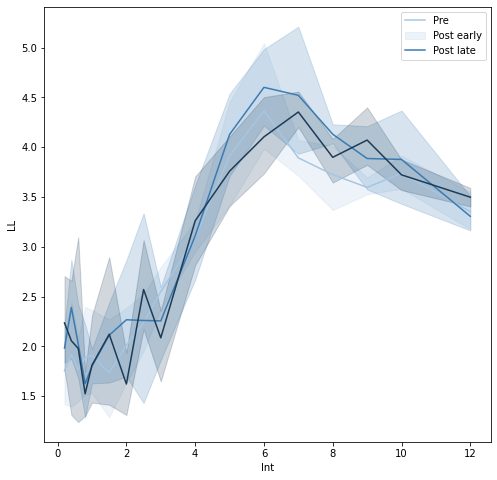

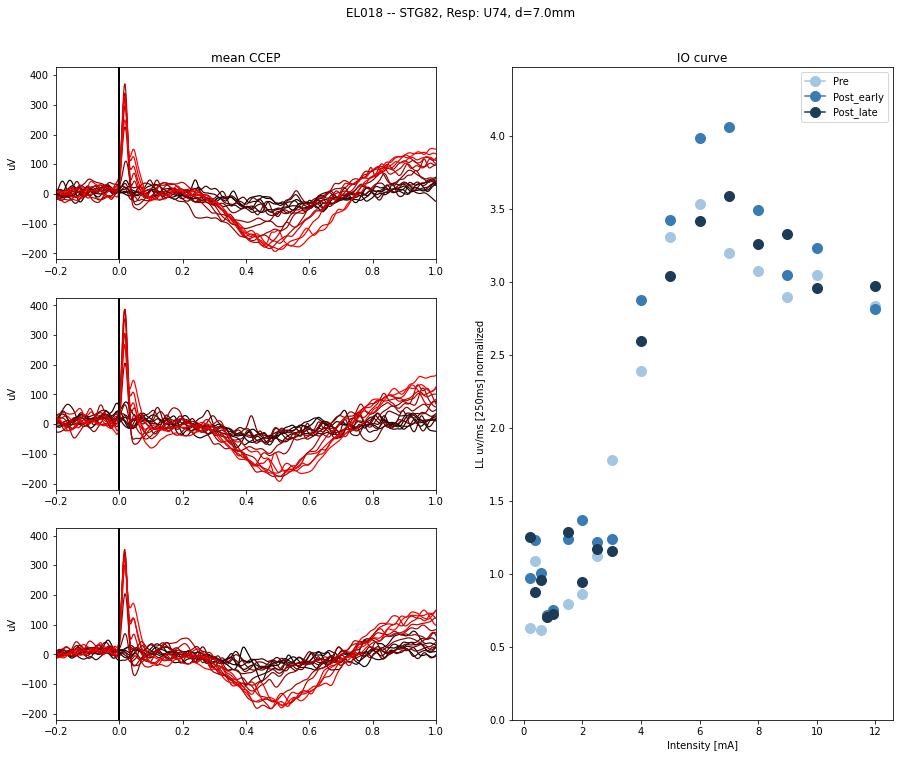

73


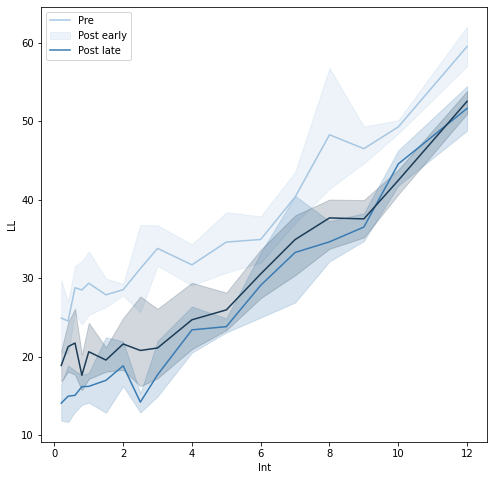

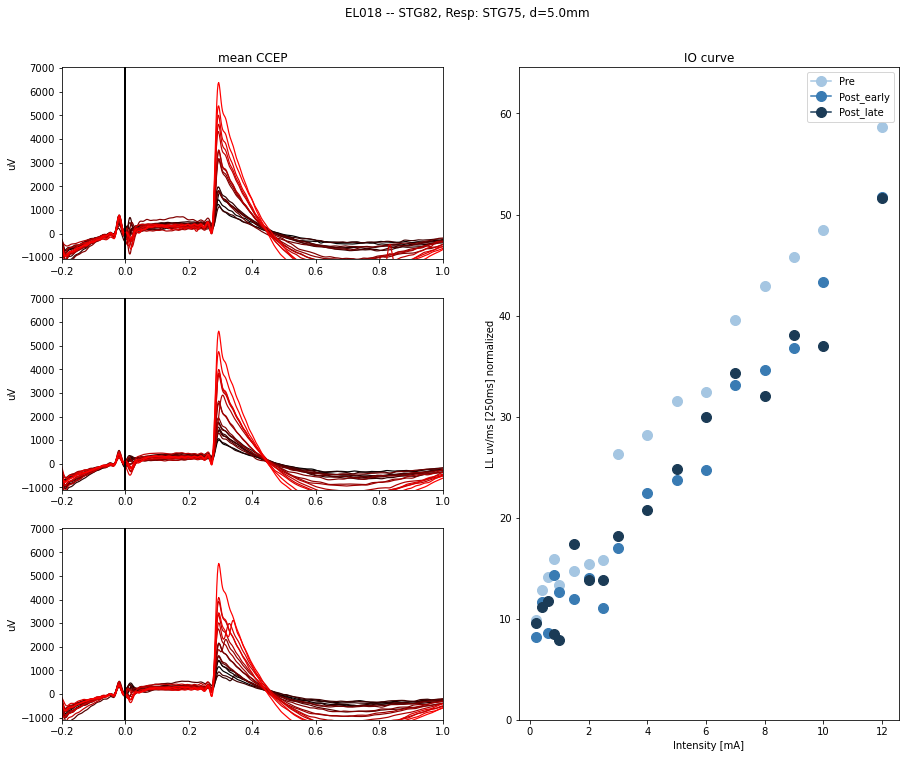

74


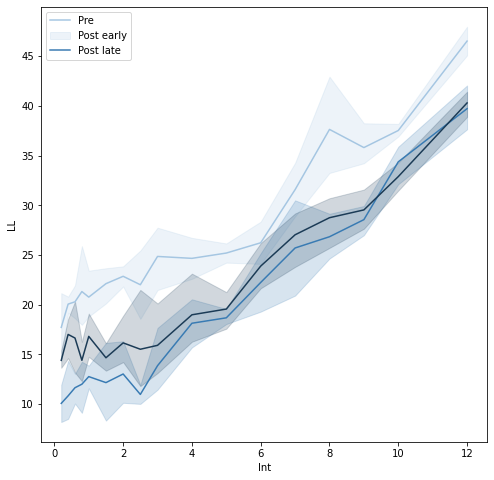

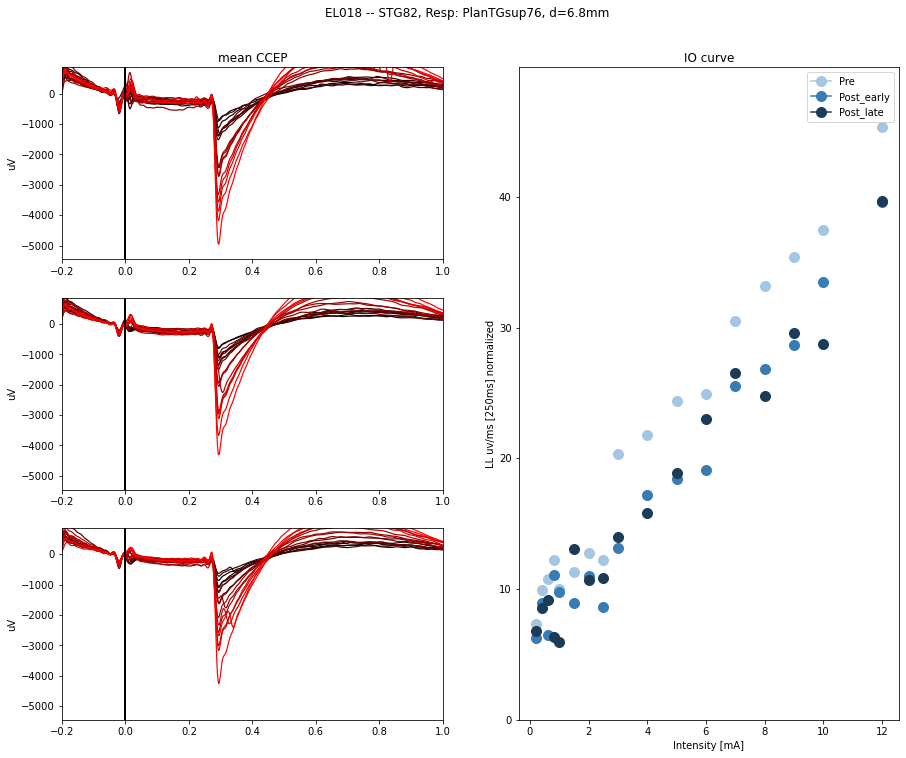

75


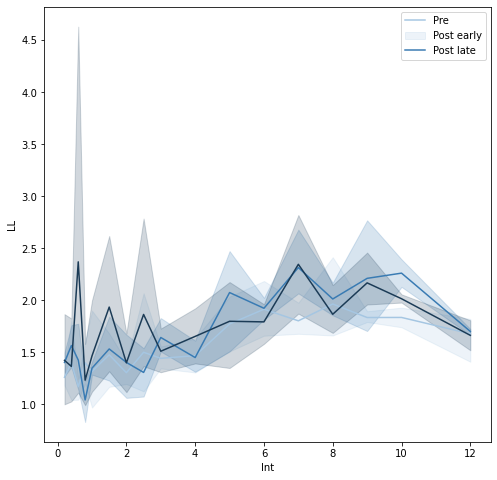

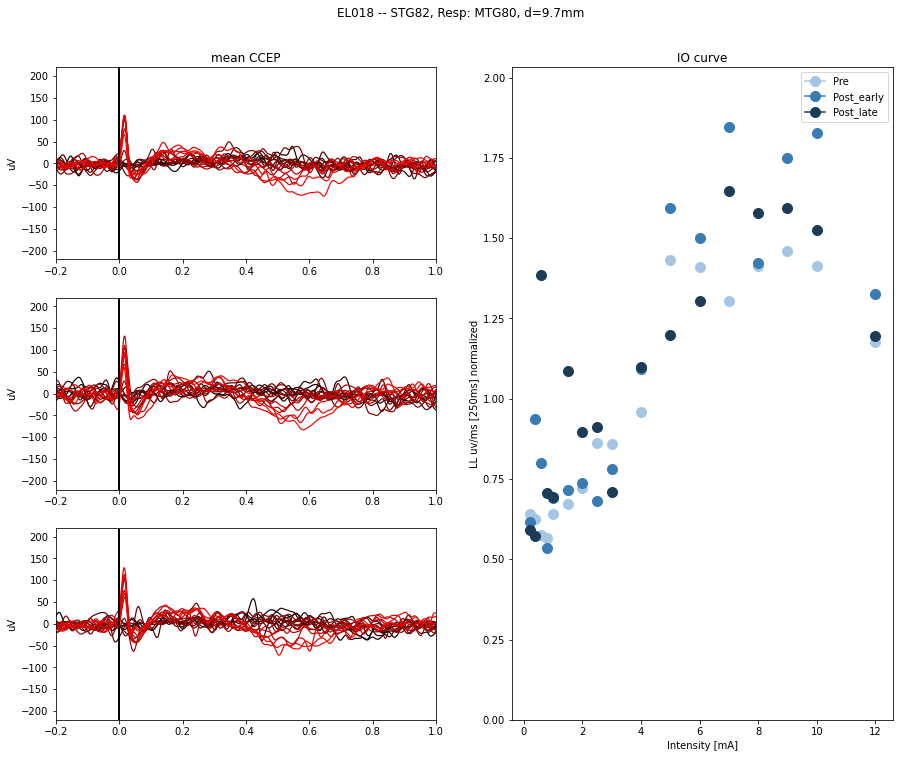

79


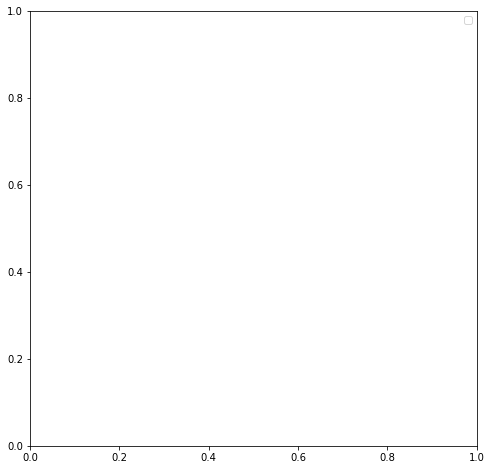

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


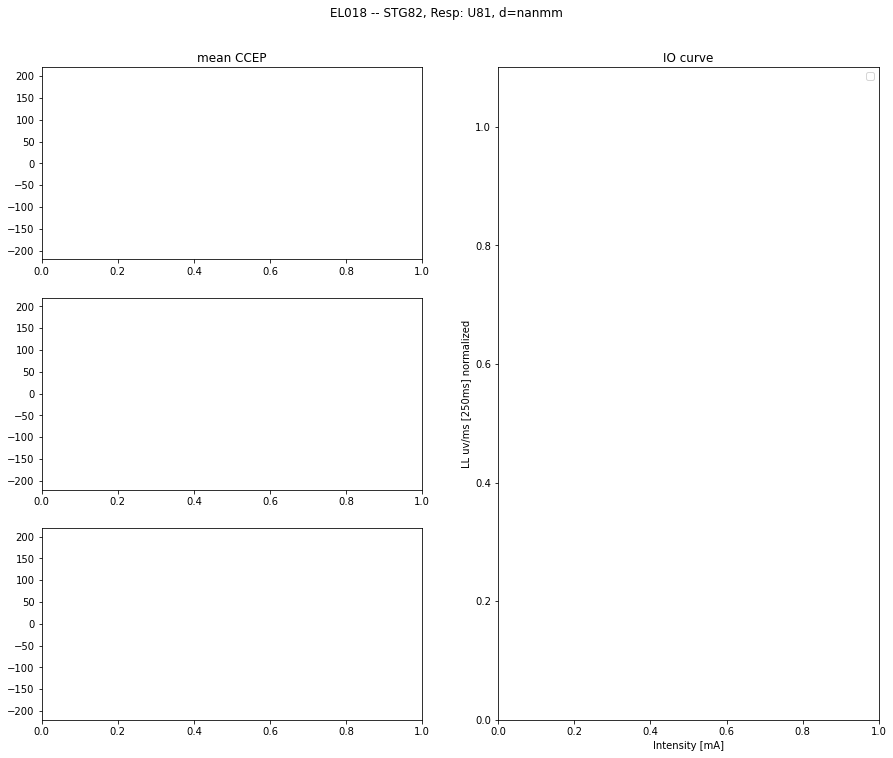

80


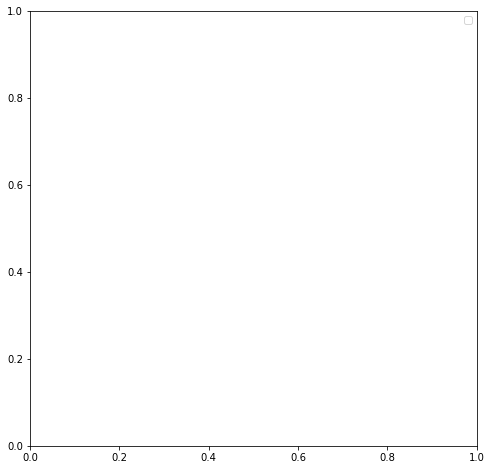

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


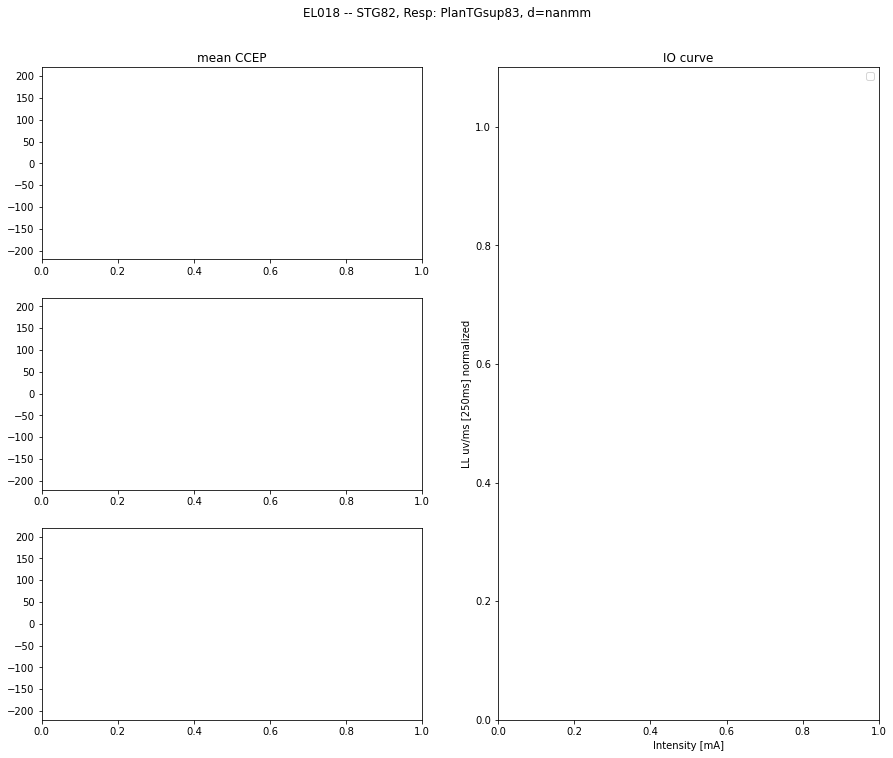

82


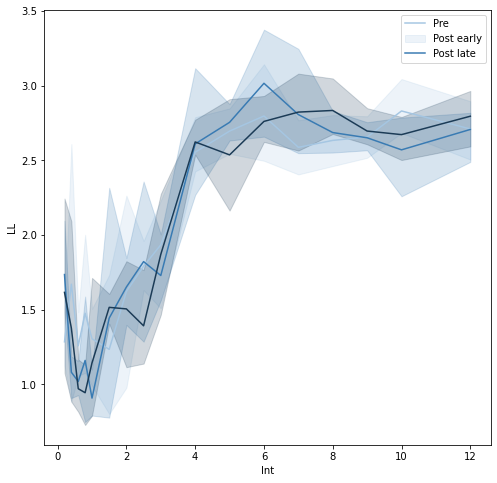

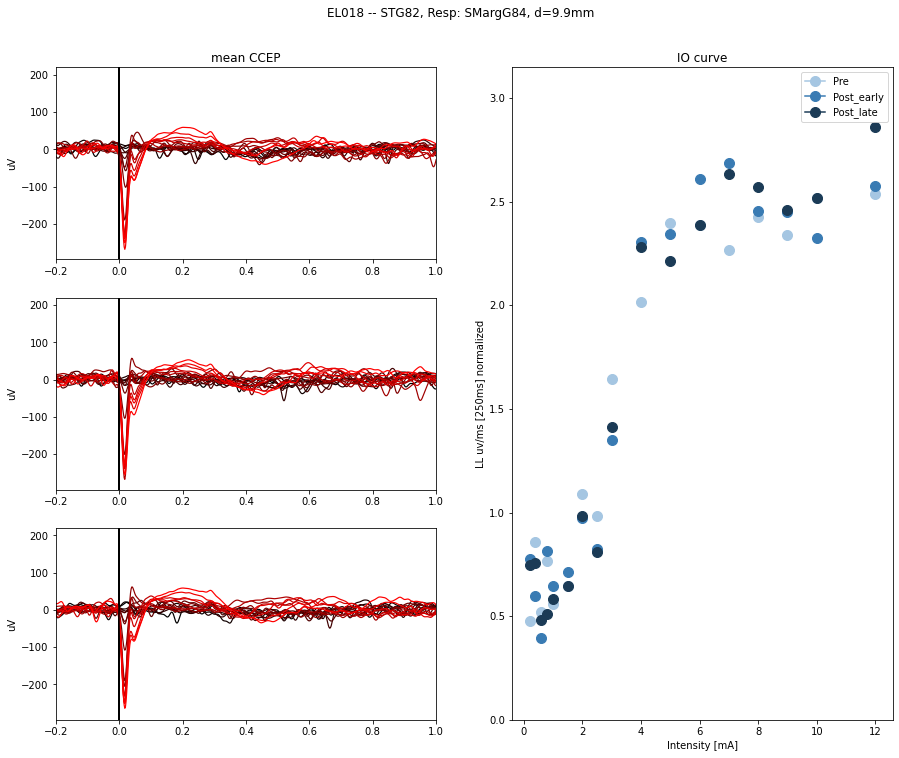

83


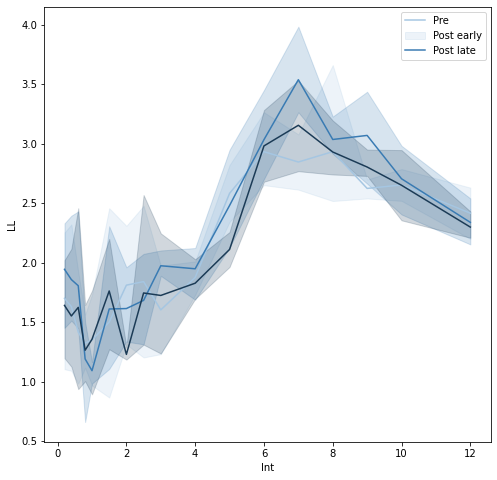

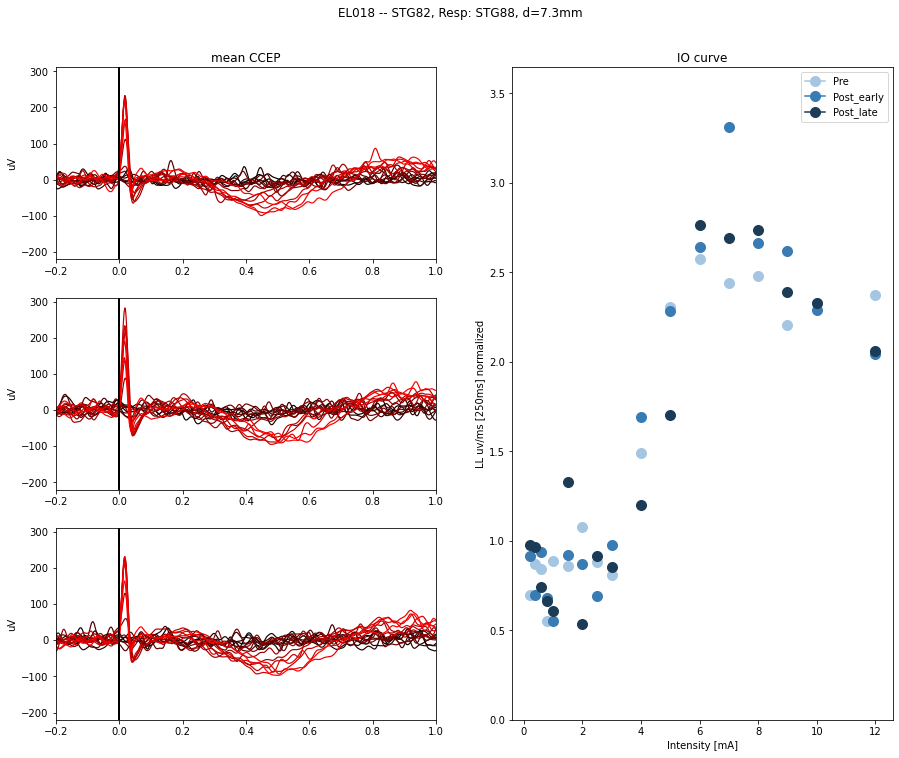

87


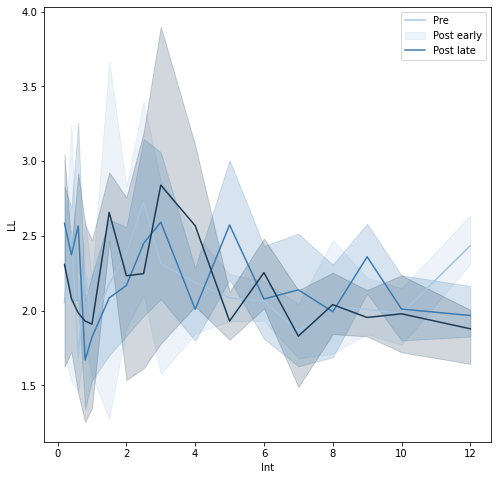

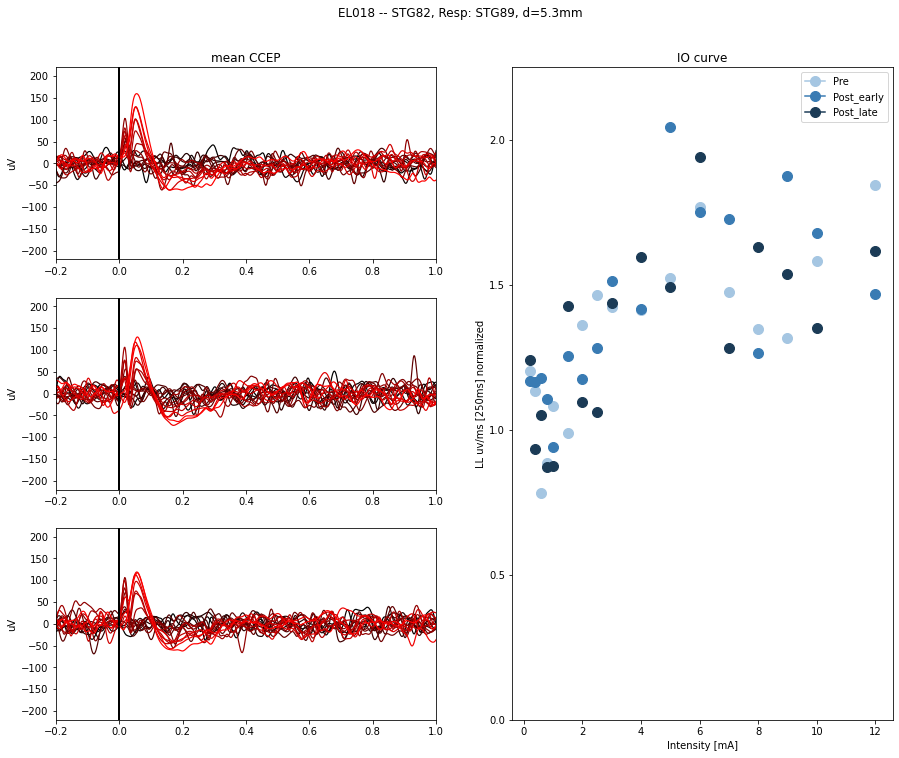

88


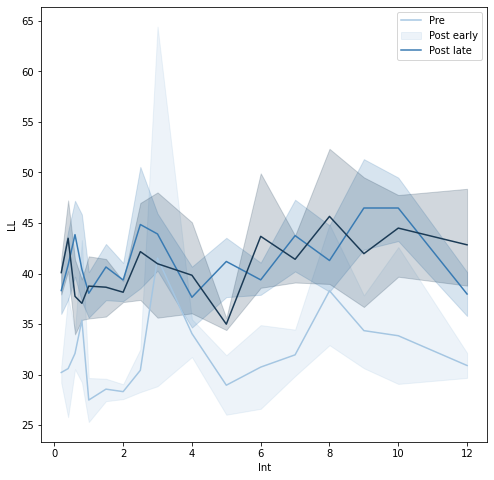

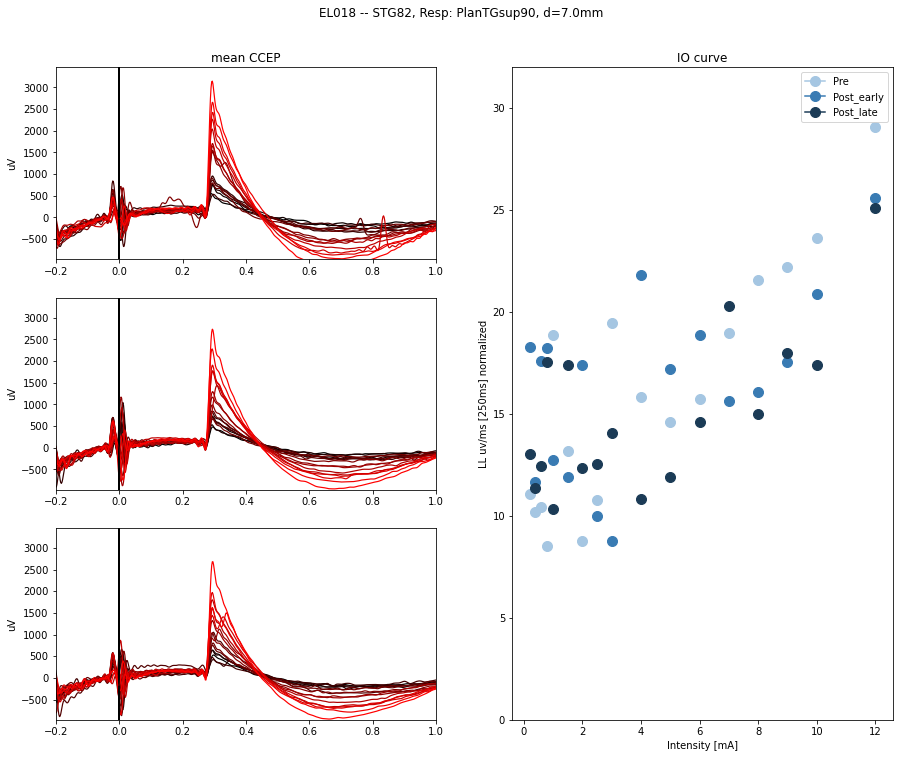

89


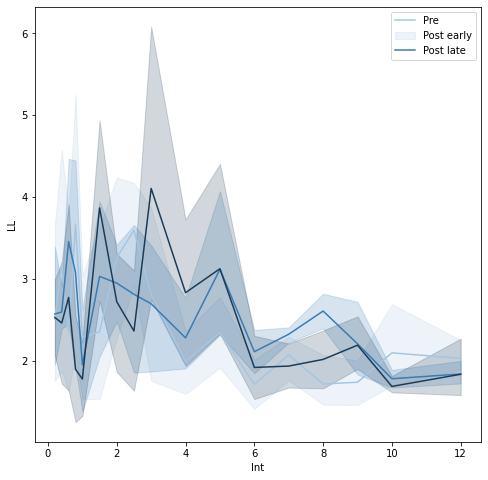

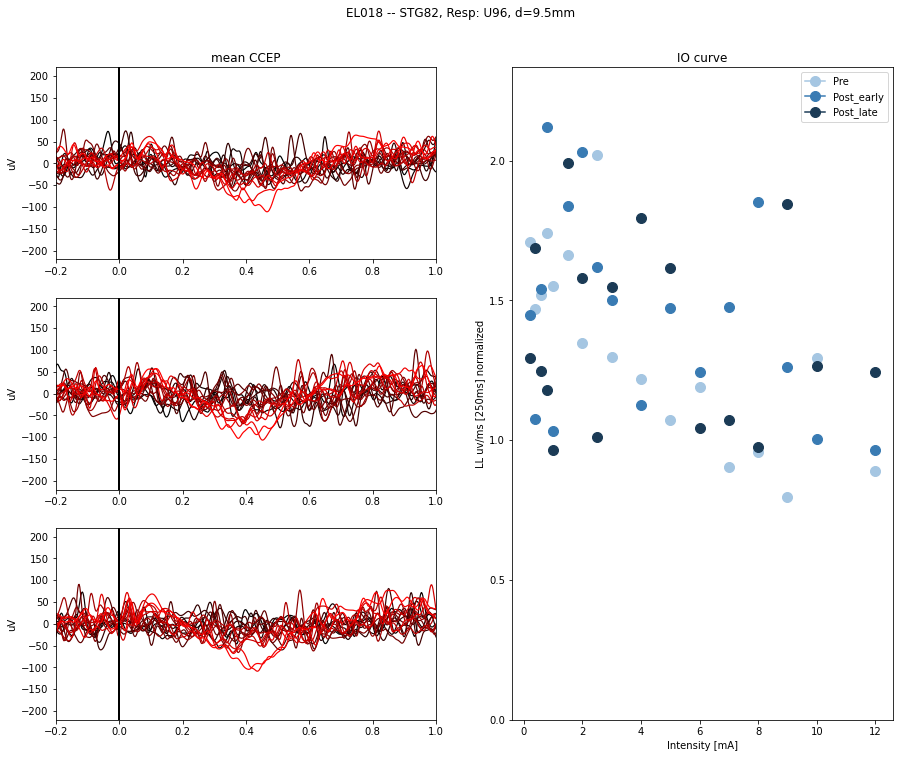

95


In [12]:
## mean LL of single trials LL  grouped based on condition

for rc in np.unique(LL_all.loc[(LL_all.d>0)&(LL_all.d<10),'Chan']).astype('int'):

    datIO      = LL_all[(LL_all['type']=='LTD1_IO')&(LL_all['Artefact']==0)&(LL_all['Chan']==rc)] #(LL_all['Stim']>32)& #&(LL_all['Sig_Con']>0)
    #sc = int(datIO.Stim.values[0])
    palette = sns.color_palette(color_elab[:3])
    plt.figure(figsize=(8,8))
    sns.lineplot(x='Int', y='LL', data=datIO, hue='Condition', palette = palette)
    plt.legend(cond_label[:3])
    plt.show()
    
    plot_raw_LL_IO_LTI(sc, rc, datIO,EEG_resp,labels_all)
    plt.show()
    print(rc)


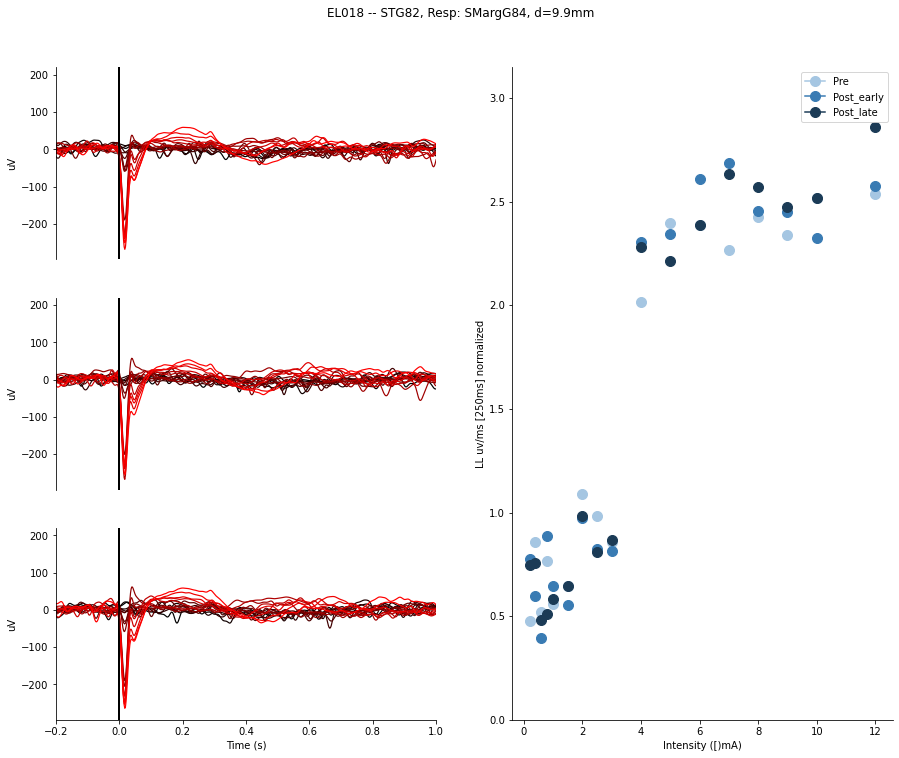

In [13]:
rc=83

dat      = LL_all[(LL_all['Stim']==sc)&(LL_all['Chan']==rc)]
w        = 0.25
fig, axs = plt.subplots(len(cond_vals),2, figsize=(15, 8), facecolor='w', edgecolor='k')
axs     = axs.ravel()
plt.close(fig) # todo: find better solution
fig      = plt.figure(figsize=(15,len(cond_vals)*4), facecolor='w', edgecolor='k')
#
gs       = fig.add_gridspec(len(cond_vals),2)  # GridSpec(4,1, height_ratios=[1,2,1,2])
for n in cond_vals:
    axs[n] = fig.add_subplot(gs[n, 0])

axIO   = fig.add_subplot(gs[:, 1])
plt.suptitle(subj+' -- '+labels_all[np.int64(sc)]+', Resp: '+labels_all[np.int64(rc)]+', d='+str(np.round(np.mean(dat.d),1))+'mm', y=0.95)
limy_LL          = 3 # limits for LL plot
limy_mx        = 200
limy_mn        = -200
Int_selc         = np.unique(dat.Int)
colors_Int       = np.zeros((len(Int_selc), 3))
colors_Int[:, 0] = np.linspace(0, 1, len(Int_selc))
mx_LL =1
for c,j in zip(cond_labels, cond_vals):
    Int_selc = np.unique(dat.loc[(dat.Stim==sc)&(dat.Chan==rc)&(dat.Condition==c), 'Int'])
    for i in range(len(Int_selc)):
        dati = dat[(dat.Int==Int_selc[i])&(dat.Stim==sc)&(dat.Chan==rc)&(dat.Condition==c)]
        if len(dati)>0:
            resp             = ff.lp_filter(np.nanmean(EEG_resp[rc,dati.Num.values.astype('int'),: ], 0),45,Fs)
            LL_resp = LLf.get_LL_all(np.expand_dims(resp,[0,1]), Fs, 0.25)[0][0]

            LL_resp             = ff.lp_filter(LL_resp,20,Fs)
            axs[j].plot( x_ax,resp, c = colors_Int[i], linewidth= 1.2)
            axs[j].set_xlim(-0.2, 0.5)
            # axs[1].plot( x_ax,LL_resp, c = colors_Int[i], linewidth= 1.2)
            mx = np.max(LL_resp[500:750])
            mx_t = np.argmax(LL_resp[500:750]) /Fs
            # axs[1].plot(mx_t,mx, marker='o', c = [0,0,0], markersize= 10)


            if i == len(Int_selc)-1:
                axIO.plot(Int_selc[i], mx, marker='o', markersize=10, c = color_elab[j], label=c)
            else:
                axIO.plot(Int_selc[i], mx, marker='o', markersize=10, c = color_elab[j])
                
            axIO.spines.top.set_visible(False)
            axIO.spines.right.set_visible(False)
                                       
            limy_mx = np.nanmax([limy_mx, np.max(resp[500:750])])
            limy_mn = np.nanmin([limy_mn, np.min(resp[500:750])])
            mx_LL = np.max([mx_LL, mx])
            axs[j ].axvline(0, c=[0,0,0])   
            axs[j].set_xlim(-0.2, 1)
            axs[j].set_ylabel('uV')
            
            axs[j].spines.top.set_visible(False)
            axs[j].spines.right.set_visible(False)
            axs[j].set_xlabel('Time (s)')
            
            if c != 'Post_late':
                     
                axs[j].get_xaxis().set_visible(False)
                axs[j].spines.bottom.set_visible(False)
                
#axIO.set_title('IO curve')
axIO.set_ylabel('LL uv/ms [250ms] normalized')
axIO.set_xlabel('Intensity ([)mA)')
axIO.set_ylim([0,1.1*mx_LL])
axIO.legend()

#axs[0].set_title('mean CCEP')

# axs[1].set_ylabel('uV/ms')
for n in cond_vals:
    axs[n].set_ylim(1.1*limy_mn,1.1*limy_mx)
    
fig.savefig(path_analysis + '\\' + subj + '_' + labels_all[np.int64(rc)] +'IOplot' + '.png', dpi = 300)

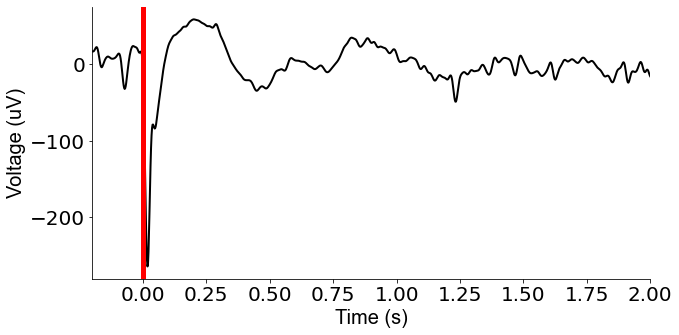

In [14]:
hfont = {'fontname':'Arial'}

plt.figure(figsize=(10,5))
ax = plt.subplot(111)
ax.plot(x_ax,resp,color='black',linewidth=2)

ax.spines.top.set(visible=False)
ax.spines.right.set(visible=False)
ax.set_ylabel('Voltage (uV)',**hfont,fontsize=20)
ax.set_xlabel('Time (s)',**hfont,fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=20)
ax.tick_params(axis='both', which='minor', labelsize=20)
ax.set_xlim(-0.2, 2)
ax.axvline(0, c='red',lw=5)


plt.savefig(path_analysis + '\\' + subj + '_single_CCEP_example_grid_2' + '.png', dpi = 300)

In [15]:
dat

,Chan,Stim,LL,P2P,type,Condition,Artefact,Int,Block,Num,Num_block,d
91632,83.0,81.0,2.865410,308.717981,LTD1_IO,Pre,0.0,5.0,1.0,0.0,0.0,9.93
91633,83.0,81.0,0.983396,39.927882,LTD1_IO,Pre,0.0,0.8,1.0,1.0,1.0,9.93
91634,83.0,81.0,0.840823,31.146799,LTD1_IO,Pre,0.0,1.0,1.0,2.0,2.0,9.93
91635,83.0,81.0,2.859782,309.724133,LTD1_IO,Pre,0.0,8.0,1.0,3.0,3.0,9.93
91636,83.0,81.0,2.429750,236.387374,LTD1_IO,Pre,0.0,4.0,1.0,4.0,4.0,9.93
...,...,...,...,...,...,...,...,...,...,...,...,...
92731,83.0,81.0,0.904705,31.229207,LTD1_IO,Post_late,0.0,1.0,12.0,1139.0,1139.0,9.93
92732,83.0,81.0,2.631382,314.768657,LTD1_IO,Post_late,0.0,9.0,12.0,1140.0,1140.0,9.93
92733,83.0,81.0,0.959421,47.587604,LTD1_IO,Post_late,0.0,0.8,12.0,1141.0,1141.0,9.93
92734,83.0,81.0,2.657893,322.219009,LTD1_IO,Post_late,0.0,10.0,12.0,1142.0,1142.0,9.93
